# Import Libraries

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import missingno 
import scipy 
import os
import plotly.express as px 
import plotly.graph_objects as go
from plotly.subplots import make_subplots
for dirname, _, filenames in os.walk('/kaggle/input/'):
    for filename in filenames:
        print(os.path.join(dirname, filename))
import warnings
warnings.filterwarnings("ignore")

# Load data:

In [3]:
weather_data = pd.read_csv("C:/Users/arshdeep/Desktop/STUDY MATERIAL/IndianWeatherRepository.csv")
weather_df= pd.read_csv("C:/Users/arshdeep/Desktop/STUDY MATERIAL/IndianWeatherRepository.csv", index_col=0)

# Data exploration and cleaning:

In [4]:
weather_data.describe()
# Generate descriptive statistics
desc_stats = weather_data.describe()
# Print the descriptive statistics
print(desc_stats)
# Select numerical columns from the DataFrame
weather_df = weather_data.select_dtypes(include='number')
# Get the column names
cols = weather_df.columns.values
# Print the column names
print(cols)
weather_df.drop(['temperature_fahrenheit','wind_mph','pressure_in','precip_mm','feels_like_fahrenheit','visibility_km','gust_mph'], axis=1,inplace=True)
weather_df.columns

           latitude     longitude  last_updated_epoch  temperature_celsius  \
count  82699.000000  82699.000000        8.269900e+04         82699.000000   
mean      23.097189     80.242151        1.699957e+09            19.720920   
std        5.793413      5.758922        3.946130e+06             6.066289   
min        7.170000     68.970000        1.693286e+09           -18.200000   
25%       20.270000     76.070000        1.696455e+09            16.100000   
50%       23.950000     78.690000        1.700079e+09            20.800000   
75%       26.770000     83.900000        1.703444e+09            24.100000   
max       34.570000     95.800000        1.706638e+09            38.300000   

       temperature_fahrenheit      wind_mph      wind_kph   wind_degree  \
count            82699.000000  82699.000000  82699.000000  82699.000000   
mean                67.497890      4.671613      7.523625    151.565847   
std                 10.919021      2.620269      4.208383    114.148030 

Index(['latitude', 'longitude', 'last_updated_epoch', 'temperature_celsius',
       'wind_kph', 'wind_degree', 'pressure_mb', 'precip_in', 'humidity',
       'cloud', 'feels_like_celsius', 'visibility_miles', 'uv_index',
       'gust_kph', 'air_quality_Carbon_Monoxide', 'air_quality_Ozone',
       'air_quality_Nitrogen_dioxide', 'air_quality_Sulphur_dioxide',
       'air_quality_PM2.5', 'air_quality_PM10', 'air_quality_us-epa-index',
       'air_quality_gb-defra-index', 'moon_illumination'],
      dtype='object')

# Data visualization:

## a) Histograms

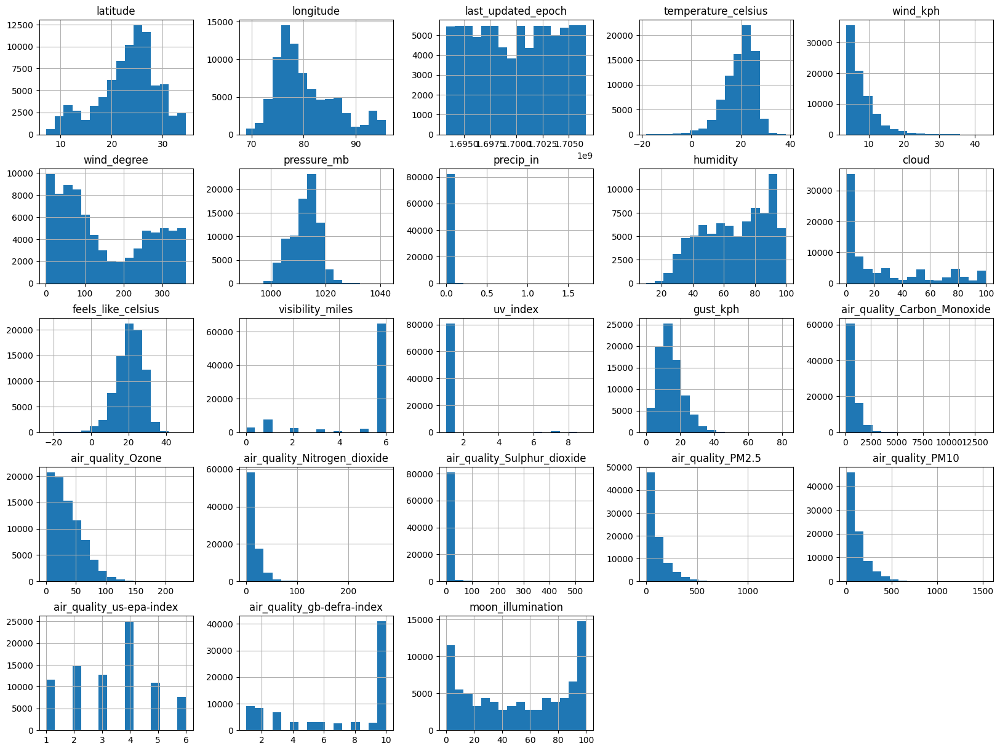

In [5]:

weather_df.hist(bins=16, figsize=(20,15));

## b) Correlation Matrix

Fields with max correlation are:

                                                       Correlation
air_quality_PM10           air_quality_gb-defra-index     0.818932
air_quality_gb-defra-index air_quality_PM10               0.818932
air_quality_PM2.5          air_quality_gb-defra-index     0.847386
air_quality_gb-defra-index air_quality_PM2.5              0.847386
                           air_quality_us-epa-index       0.861438
air_quality_us-epa-index   air_quality_gb-defra-index     0.861438
                           air_quality_PM10               0.882888
air_quality_PM10           air_quality_us-epa-index       0.882888
air_quality_PM2.5          air_quality_us-epa-index       0.898653
air_quality_us-epa-index   air_quality_PM2.5              0.898653
air_quality_PM2.5          air_quality_PM10               0.933871
air_quality_PM10           air_quality_PM2.5              0.933871


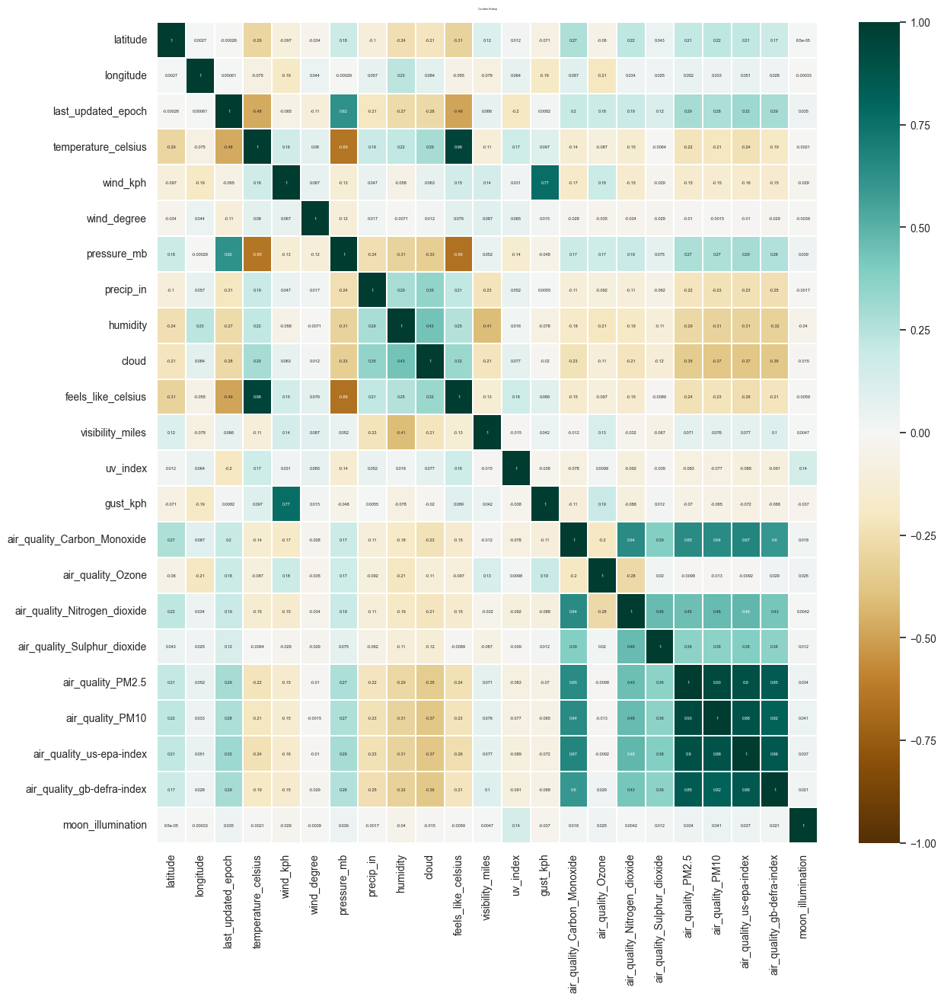

In [6]:
#Creating a correlation matrix
sns.set(font_scale=0.9)
corr_matrix = weather_df.corr(method="kendall")
plt.figure(figsize=(14, 14))
heatmap= sns.heatmap(corr_matrix, vmin=-1, vmax=1, annot=True,cmap='BrBG',annot_kws={"fontsize":4},linewidths=0.1)
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':2}, pad=12);
# Sort the correlation matrix and convert it to a DataFrame
sorted_corr_mat = corr_matrix.abs().unstack().sort_values()
sorted_corr_mat = sorted_corr_mat.to_frame(name="Correlation")
# Remove rows with correlation greater than 0.95 and less than 0.05
sorted_corr_mat = sorted_corr_mat.drop(sorted_corr_mat[sorted_corr_mat['Correlation'] > 0.95].index)
sorted_corr_mat = sorted_corr_mat.drop(sorted_corr_mat[sorted_corr_mat['Correlation'] < 0.05].index)
# Store the rows with correlation greater than 0.80 in a variable
high_corr = sorted_corr_mat[sorted_corr_mat['Correlation'] > 0.80]
# Print the rows with correlation greater than 0.80
print("Fields with max correlation are:\n")
print(high_corr)

## c) Sunburst

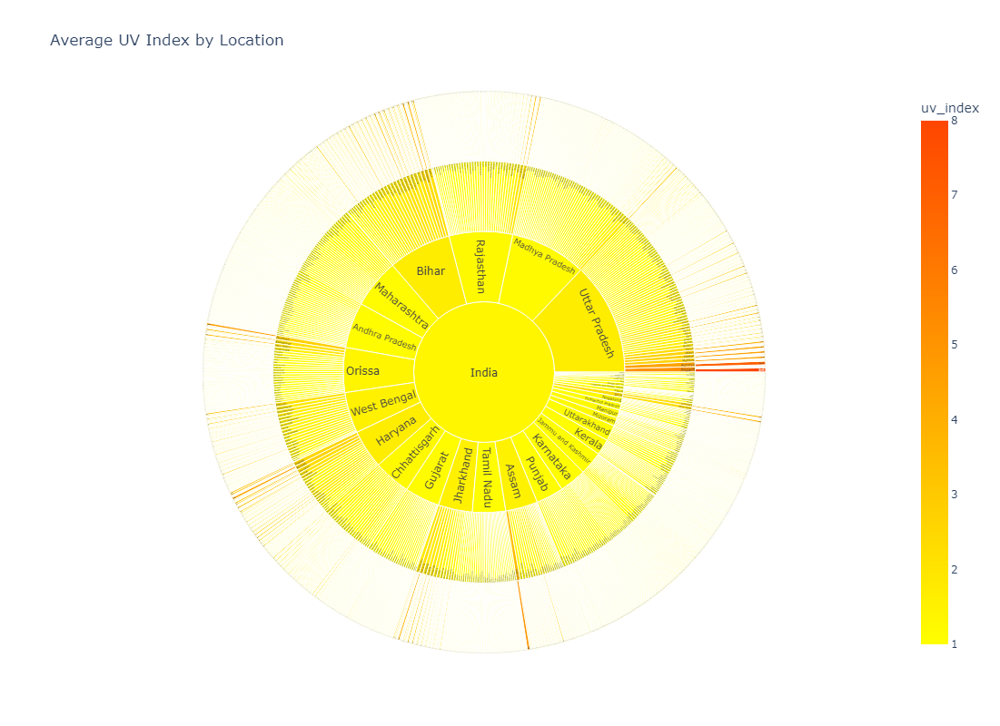

In [7]:
import pandas as pd
import plotly.express as px
weather_data = pd.read_csv("C:/Users/arshdeep/Desktop/STUDY MATERIAL/IndianWeatherRepository.csv")
grouped_data = weather_data.groupby(['country', 'region', 'location_name', 'air_quality_us-epa-index'])['uv_index'].mean().reset_index()

fig = px.sunburst(grouped_data,
                  path=['country', 'region','location_name','air_quality_us-epa-index' ],  # Added 'city' to the path
                  values='uv_index',
                  color='uv_index',
                  color_continuous_scale=[ 'yellow','orange' 'red'],  # Specify a color scale from green to red
                  title='Average UV Index by Location')

fig.update_layout(autosize=False, width=1000, height=800)  # Set the size of the figure

fig.show()

## d) Box Plot

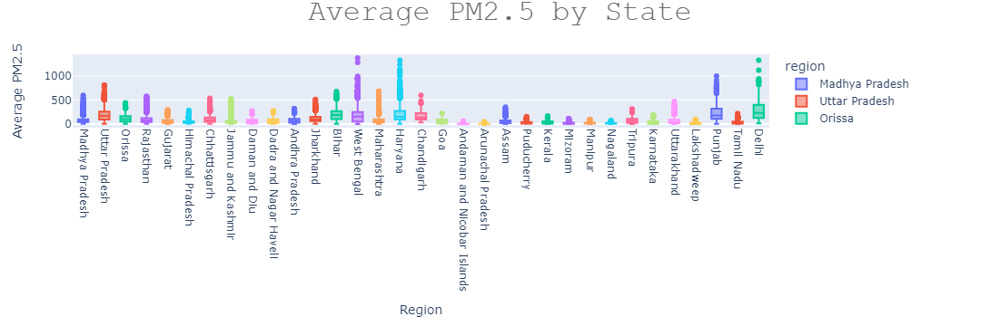

In [8]:
fig1 = px.box(weather_data, x='region', y='air_quality_PM2.5', color='region')
fig1.update_layout(
    title={'text': "Average PM2.5 by State", 'y':1.0, 'x':0.5, 'xanchor': 'center', 'yanchor': 'top'},
    title_font=dict(size=32, color='rgb(107, 107, 107)', family="Courier New, monospace"),
    xaxis_title="Region",
    yaxis_title="Average PM2.5",
    xaxis=dict(tickangle=90)
)
fig1.show()

## e) Scatter

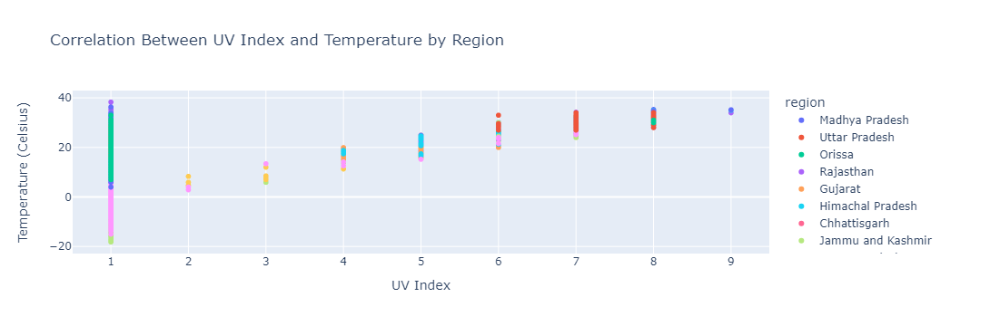

In [9]:
fig3 = px.scatter(weather_data, x='uv_index', y='temperature_celsius', color='region',
                  title='Correlation Between UV Index and Temperature by Region',
                  labels={'uv_index': 'UV Index', 'temperature_celsius': 'Temperature (Celsius)'})
fig3.update_layout(xaxis_title='UV Index', yaxis_title='Temperature (Celsius)')
fig3.show()

## f) Bar Graph

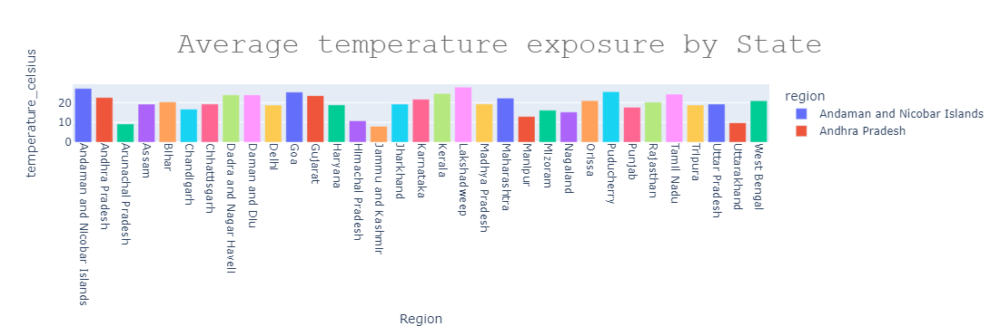

In [10]:
fig4 = px.bar(weather_data.groupby('region')['temperature_celsius'].mean().reset_index(),
              x='region', y='temperature_celsius',
              title='Average temperature exposure by State',
              color='region')  # Assign a different color to each region
fig4.update_layout(
     title={'text': "Average temperature exposure by State", 'y':0.9, 'x':0.5, 'xanchor': 'center', 'yanchor': 'top'},
    title_font=dict(size=32, color='rgb(107, 107, 107)', family="Courier New, monospace"),
    xaxis_title="Region",
    xaxis=dict(tickangle=90)
)
fig4.show()

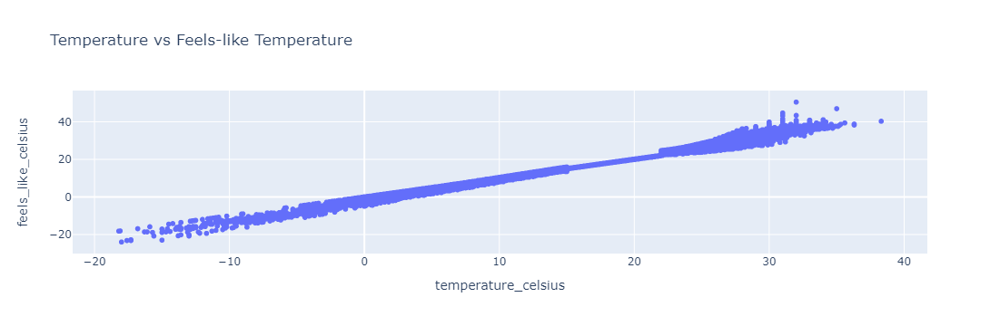

In [11]:
fig5 = px.scatter(weather_data, x="temperature_celsius", y="feels_like_celsius", title="Temperature vs Feels-like Temperature")
fig5.show()

## g) Density Mapbox

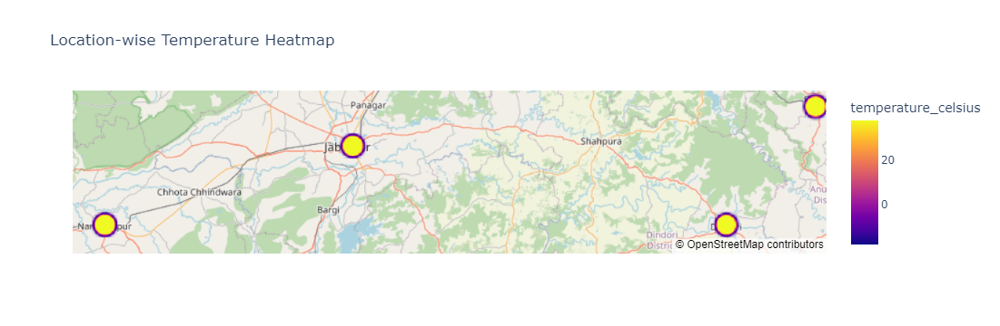

In [12]:
fig6 = px.density_mapbox(weather_data, lat="latitude", lon="longitude", z="temperature_celsius", radius=11,
                         title="Location-wise Temperature Heatmap")
fig6.update_layout(mapbox_style="open-street-map")
fig6.show()

### e.1) Scatter Polar

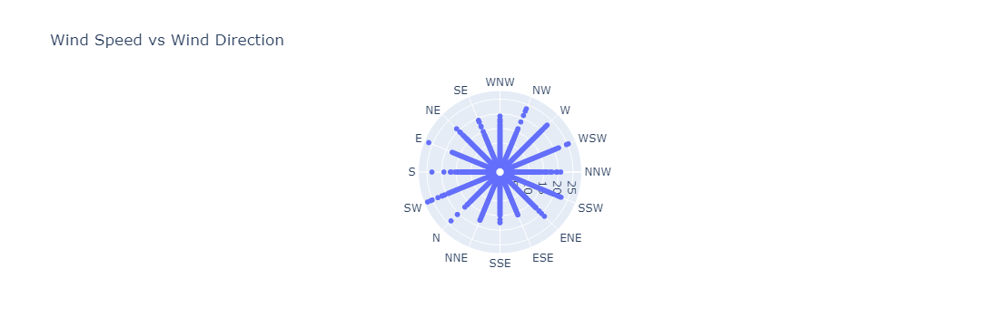

In [13]:
fig7 = px.scatter_polar(weather_data, r="wind_mph", theta="wind_direction", title="Wind Speed vs Wind Direction")
fig7.show()

## h) Sns Boxplot

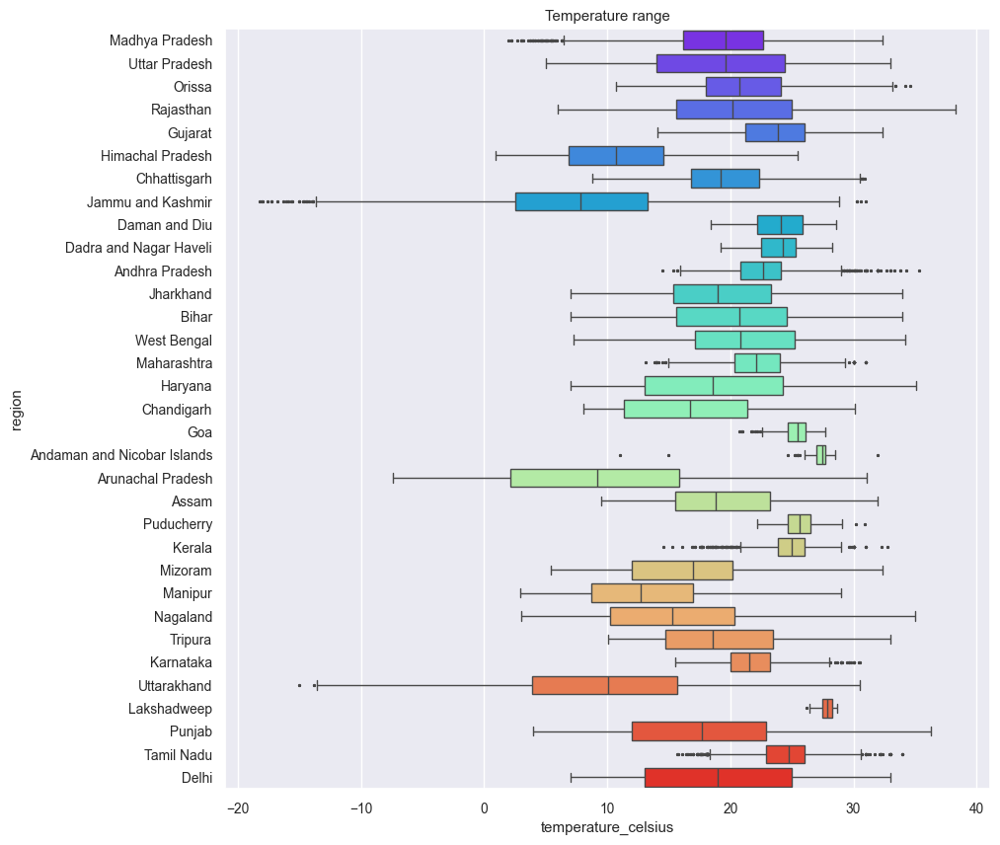

In [14]:
# Temperature range
plt.figure(figsize=(10, 10))
temp_range = sns.boxplot(data=weather_data, y='region', x='temperature_celsius', 
                         palette='rainbow',  # Set the color of the boxes
                         flierprops={'marker': '*', 'markersize': 2, 'markerfacecolor': 'blue'})
temp_range.set_title("Temperature range")

plt.show()

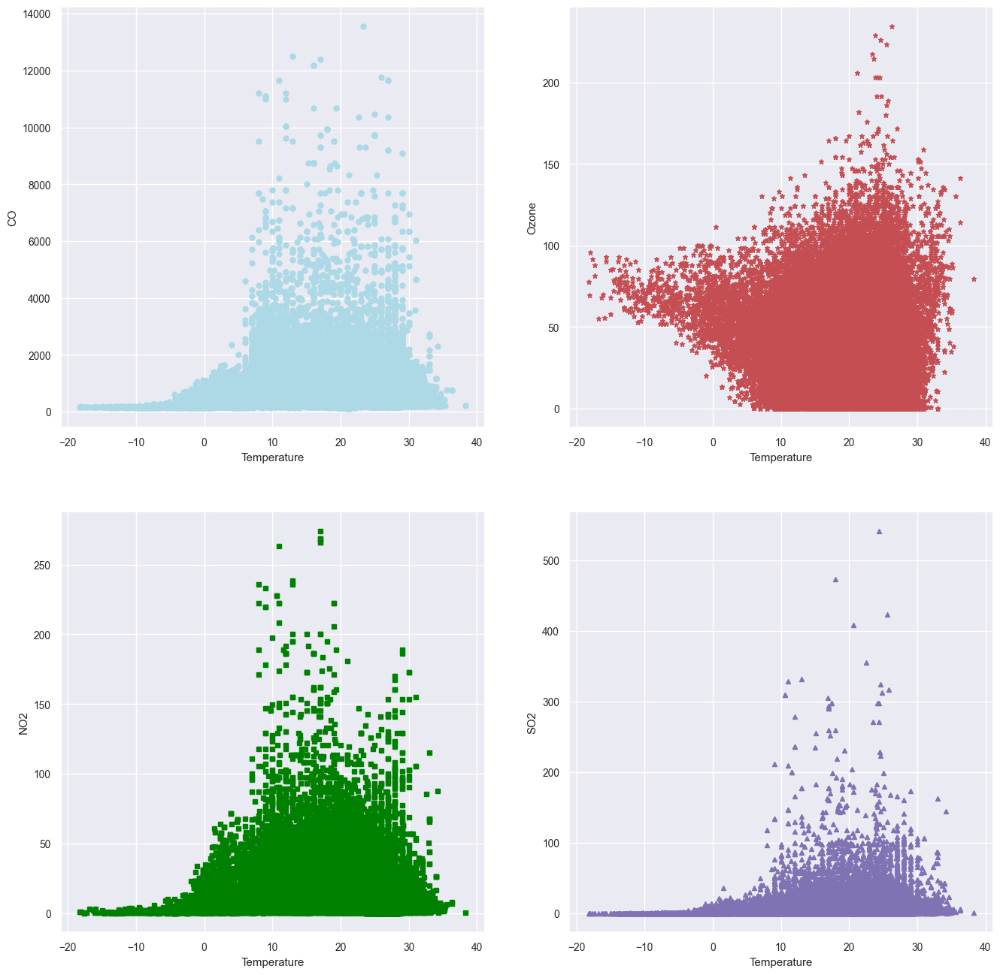

In [15]:
from sklearn import linear_model
from sklearn.preprocessing import StandardScaler
scale = StandardScaler()
temp_weather=weather_data
# Scatter Plots for Air Quality Metrics vs Temperature
air_quality_metrics = ['air_quality_Carbon_Monoxide', 'air_quality_Ozone', 'air_quality_Nitrogen_dioxide', 
                       'air_quality_Sulphur_dioxide']
plt.figure(figsize=(16, 16))
plt.subplot(2, 2, 1)
plt.plot( "temperature_celsius","air_quality_Carbon_Monoxide", data=temp_weather,color="lightblue",marker='o',ms="5",ls = '',label="CO")
plt.xlabel("Temperature")
plt.ylabel("CO")
plt.subplot(2, 2, 2)
plt.plot( "temperature_celsius","air_quality_Ozone", data=temp_weather,color="r",marker
         ='*',ms="5",ls = '',label="Ozone")
plt.xlabel("Temperature")
plt.ylabel("Ozone")
plt.subplot(2, 2, 3)
plt.plot( "temperature_celsius","air_quality_Nitrogen_dioxide", data=temp_weather,color="green",marker='s',ms="5",ls = '',label="NO2")
plt.xlabel("Temperature")
plt.ylabel("NO2")
plt.subplot(2, 2, 4)
plt.plot( "temperature_celsius","air_quality_Sulphur_dioxide", data=temp_weather,color="m",marker='^',ms="5",ls = '',label="SO2")
plt.xlabel("Temperature")
plt.ylabel("SO2")
plt.show()

## i) Graph

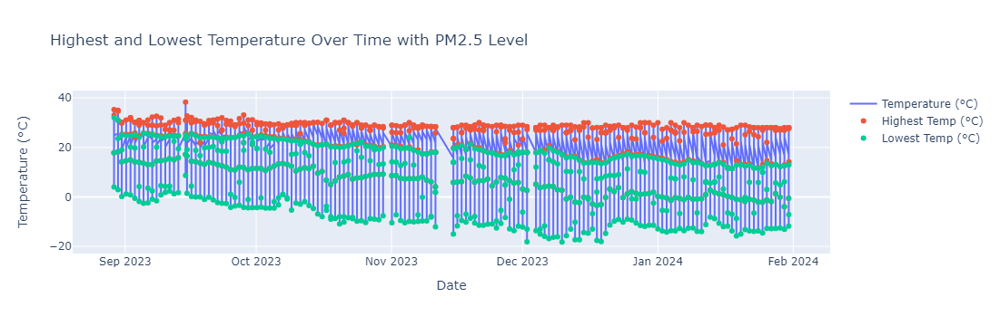

In [16]:
weather_df = pd.read_csv('C:/Users/arshdeep/Desktop/STUDY MATERIAL/IndianWeatherRepository.csv')
weather_df['last_updated'] = pd.to_datetime(weather_df['last_updated'])
import plotly.graph_objects as go

# Highest temperature over time
highest_temp_df = weather_df[weather_df.groupby(['last_updated'])['temperature_celsius'].transform(max) == weather_df['temperature_celsius']]

# Lowest temperature over time
lowest_temp_df = weather_df[weather_df.groupby(['last_updated'])['temperature_celsius'].transform(min) == weather_df['temperature_celsius']]

# Plot highest and lowest temperature over time, along with PM2.5 level
fig = go.Figure()

# Line plot for temperatures
fig.add_trace(go.Scatter(x=weather_df['last_updated'], y=weather_df['temperature_celsius'], mode='lines', name='Temperature (°C)'))

# Markers for highest temperatures
fig.add_trace(go.Scatter(x=highest_temp_df['last_updated'], y=highest_temp_df['temperature_celsius'], mode='markers', name='Highest Temp (°C)', 
                         text=highest_temp_df['air_quality_PM2.5'].apply(lambda x: f'PM2.5: {x}'),
                         hoverinfo='x+y+text'))

# Markers for lowest temperatures
fig.add_trace(go.Scatter(x=lowest_temp_df['last_updated'], y=lowest_temp_df['temperature_celsius'], mode='markers', name='Lowest Temp (°C)', 
                         text=lowest_temp_df['air_quality_PM2.5'].apply(lambda x: f'PM2.5: {x}'),
                         hoverinfo='x+y+text'))

fig.update_layout(title='Highest and Lowest Temperature Over Time with PM2.5 Level',
                  xaxis_title='Date',
                  yaxis_title='Temperature (°C)')

fig.show()

# MACHINE LEARNING

In [17]:
temperature_data = weather_df['temperature_celsius']
temperature_factors = weather_df[['latitude','longitude','wind_kph','wind_degree','pressure_mb','precip_in','humidity','cloud']]
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score

x_train, x_test, y_train, y_test = train_test_split(temperature_factors, temperature_data, test_size = 0.4, random_state = 0)
#shapes of splitted data
print("X_train:",x_train.shape)
print("X_test:", x_test.shape)
print("Y_train:", y_train.shape)
print("Y_test:", y_test.shape)
from typing import Tuple
X_train: Tuple[int, int] = (52971, 8)
X_test: Tuple[int, int] = (22702, 8)
Y_train: Tuple[int] = (52971,)
Y_test: Tuple[int] = (22702,)

X_train: (49619, 8)
X_test: (33080, 8)
Y_train: (49619,)
Y_test: (33080,)


## Temperatures

In [18]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from xgboost import XGBRegressor
from math import sqrt
import matplotlib.pyplot as plt

# Split data
x_train, x_test, y_train, y_test = train_test_split(temperature_factors, temperature_data, test_size = 0.4, random_state = 0)
print("********TEMPERATURE IN CELSIUS*********")
# Define models
models = [
    {"name": "Linear Regression", "model": LinearRegression()},
    {"name": "Lasso", "model": Lasso(alpha=0.1)},
    {"name": "Ridge", "model": Ridge(alpha=0.1)},
    {"name": "Gradient Boosting", "model": GradientBoostingRegressor()},
    {"name": "Random Forest", "model": RandomForestRegressor()},
    {"name": "XGBoost", "model": XGBRegressor()}
]

# Initialize lists to store scores
mse_scores, rmse_scores, mae_scores, r2_scores = [], [], [], []

# Initialize dictionary to store mse values
mse_dict = {}

# Train models, make predictions, calculate errors
for model_info in models:
    model = model_info["model"]
    model.fit(x_train, y_train)
    y_pred = model.predict(x_test)
    mse_scores.append(mean_squared_error(y_test, y_pred))
    rmse_scores.append(sqrt(mse_scores[-1]))
    mae_scores.append(mean_absolute_error(y_test, y_pred))
    r2_scores.append(r2_score(y_test, y_pred))
    print(f"{model_info['name']}'s R2: {r2_scores[-1]:.2f}, MSE: {mse_scores[-1]:.2f}, RMSE: {rmse_scores[-1]:.2f}, MAE: {mae_scores[-1]:.2f}")

    # Store mse value in dictionary with model name as key
    mse_dict[model_info['name']] = mse_scores[-1]

********TEMPERATURE IN CELSIUS*********
Linear Regression's R2: 0.73, MSE: 10.15, RMSE: 3.19, MAE: 2.48
Lasso's R2: 0.73, MSE: 10.19, RMSE: 3.19, MAE: 2.48
Ridge's R2: 0.73, MSE: 10.15, RMSE: 3.19, MAE: 2.48
Gradient Boosting's R2: 0.87, MSE: 4.83, RMSE: 2.20, MAE: 1.66
Random Forest's R2: 0.94, MSE: 2.27, RMSE: 1.51, MAE: 1.00
XGBoost's R2: 0.92, MSE: 2.94, RMSE: 1.71, MAE: 1.24


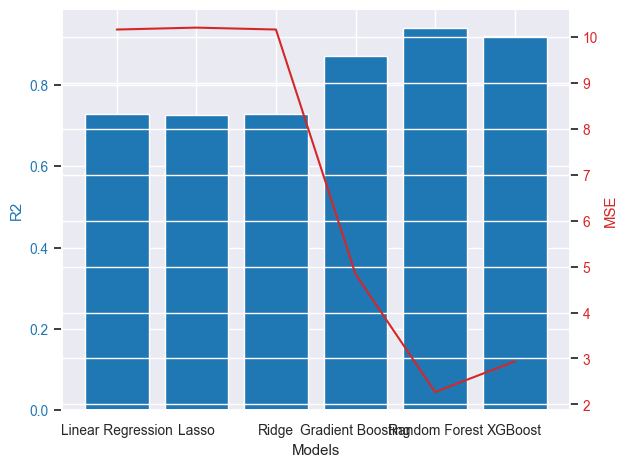

In [19]:
# Plotting
fig, ax1 = plt.subplots()
ax1.set_xlabel('Models')
ax1.set_ylabel('R2', color='tab:blue')
ax1.bar([model_info['name'] for model_info in models], r2_scores, color='tab:blue')
ax1.tick_params(axis='y', labelcolor='tab:blue')

ax2 = ax1.twinx()  
ax2.set_ylabel('MSE', color='tab:red')  
ax2.plot([model_info['name'] for model_info in models], mse_scores, color='tab:red')
ax2.tick_params(axis='y', labelcolor='tab:red')

fig.tight_layout()  
plt.show()



In [20]:
# Print the dictionary of mse values
print("********MSE VALUES*********")
print(mse_dict)

********MSE VALUES*********
{'Linear Regression': 10.152643024006789, 'Lasso': 10.194053377203778, 'Ridge': 10.152678951501764, 'Gradient Boosting': 4.832718313148895, 'Random Forest': 2.2709465203356776, 'XGBoost': 2.9372903332829843}


## Feels Like Temperature

In [21]:
print("********FEELS LIKE TEMPERATURE IN CELSIUS********")
feels_like_data = weather_df['feels_like_celsius']
feels_like_factors = weather_df[['latitude','longitude','wind_kph','wind_degree','pressure_mb','precip_in','humidity','cloud']]

# Split data
x_train, x_test, y_train, y_test = train_test_split(feels_like_factors, feels_like_data, test_size = 0.4, random_state = 0)

# Define models
models = [
    {"name": "Linear Regression", "model": LinearRegression()},
    {"name": "Lasso", "model": Lasso(alpha=0.1)},
    {"name": "Ridge", "model": Ridge(alpha=0.1)},
    {"name": "Gradient Boosting", "model": GradientBoostingRegressor()},
    {"name": "Random Forest", "model": RandomForestRegressor()},
    {"name": "XGBoost", "model": XGBRegressor()}
]

# Initialize lists to store scores
mse_scores, rmse_scores, mae_scores, r2_scores = [], [], [], []

# Initialize dictionary to store mse values
feels_like_mse_dict = {}

# Train models, make predictions, calculate errors
for model_info in models:
    model = model_info["model"]
    model.fit(x_train, y_train)
    y_pred = model.predict(x_test)
    mse_scores.append(mean_squared_error(y_test, y_pred))
    rmse_scores.append(sqrt(mse_scores[-1]))
    mae_scores.append(mean_absolute_error(y_test, y_pred))
    r2_scores.append(r2_score(y_test, y_pred))
    print(f"{model_info['name']}'s R2: {r2_scores[-1]:.2f}, MSE: {mse_scores[-1]:.2f}, RMSE: {rmse_scores[-1]:.2f}, MAE: {mae_scores[-1]:.2f}")

    # Store mse value in dictionary with model name as key
    feels_like_mse_dict[model_info['name']] = mse_scores[-1]

********FEELS LIKE TEMPERATURE IN CELSIUS********
Linear Regression's R2: 0.75, MSE: 13.39, RMSE: 3.66, MAE: 2.85
Lasso's R2: 0.75, MSE: 13.43, RMSE: 3.67, MAE: 2.85
Ridge's R2: 0.75, MSE: 13.39, RMSE: 3.66, MAE: 2.85
Gradient Boosting's R2: 0.87, MSE: 7.08, RMSE: 2.66, MAE: 2.03
Random Forest's R2: 0.94, MSE: 3.22, RMSE: 1.79, MAE: 1.22
XGBoost's R2: 0.92, MSE: 4.20, RMSE: 2.05, MAE: 1.53


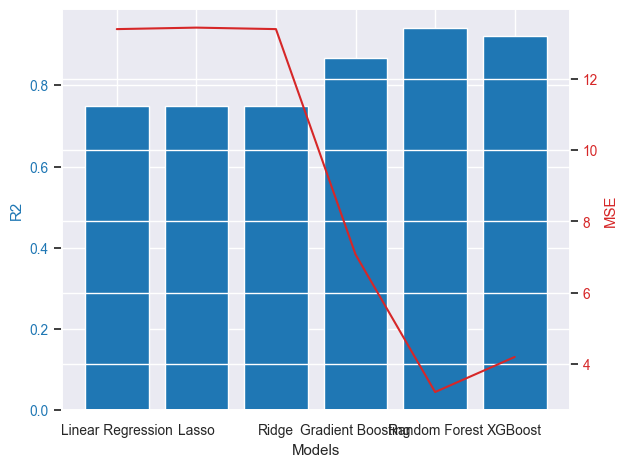

In [22]:
# Plotting
fig, ax1 = plt.subplots()
ax1.set_xlabel('Models')
ax1.set_ylabel('R2', color='tab:blue')
ax1.bar([model_info['name'] for model_info in models], r2_scores, color='tab:blue')
ax1.tick_params(axis='y', labelcolor='tab:blue')

ax2 = ax1.twinx()  
ax2.set_ylabel('MSE', color='tab:red')  
ax2.plot([model_info['name'] for model_info in models], mse_scores, color='tab:red')
ax2.tick_params(axis='y', labelcolor='tab:red')

fig.tight_layout()  
plt.show()


In [23]:

# Print the dictionary of mse values
print("********MSE VALUES*********")
print(feels_like_mse_dict)

********MSE VALUES*********
{'Linear Regression': 13.39161331857987, 'Lasso': 13.433273078897733, 'Ridge': 13.391653851406465, 'Gradient Boosting': 7.075959463693492, 'Random Forest': 3.2192950018099014, 'XGBoost': 4.20215230235495}


## Cloud

In [24]:
print("********CLOUD********")
cloud_data = weather_df['cloud']
cloud_factors = weather_df[['latitude','longitude','wind_kph','wind_degree','pressure_mb','precip_in','humidity','temperature_celsius']]

# Split the data
x_train, x_test, y_train, y_test = train_test_split(cloud_factors, cloud_data, test_size = 0.4, random_state = 0)

# Define the models
models = [
    {"name": "Linear Regression", "model": LinearRegression()},
    {"name": "Lasso", "model": Lasso(alpha=0.1)},
    {"name": "Ridge", "model": Ridge(alpha=0.1)},
    {"name": "Gradient Boosting", "model": GradientBoostingRegressor()},
    {"name": "Random Forest", "model": RandomForestRegressor()},
    {"name": "XGBoost", "model": XGBRegressor()}
]

# Initialize lists to store scores
mse_scores, rmse_scores, mae_scores, r2_scores = [], [], [], []

# Initialize dictionary to store mse values
cloud_mse_dict = {}

# Train models, make predictions, calculate errors
for model_info in models:
    model = model_info["model"]
    model.fit(x_train, y_train)
    y_pred = model.predict(x_test)
    mse_scores.append(mean_squared_error(y_test, y_pred))
    rmse_scores.append(sqrt(mse_scores[-1]))
    mae_scores.append(mean_absolute_error(y_test, y_pred))
    r2_scores.append(r2_score(y_test, y_pred))
    print(f"{model_info['name']}'s R2: {r2_scores[-1]:.2f}, MSE: {mse_scores[-1]:.2f}, RMSE: {rmse_scores[-1]:.2f}, MAE: {mae_scores[-1]:.2f}")

    # Store mse value in dictionary with model name as key
    cloud_mse_dict[model_info['name']] = mse_scores[-1]


********CLOUD********
Linear Regression's R2: 0.37, MSE: 612.15, RMSE: 24.74, MAE: 18.91
Lasso's R2: 0.36, MSE: 627.01, RMSE: 25.04, MAE: 19.27
Ridge's R2: 0.37, MSE: 612.17, RMSE: 24.74, MAE: 18.91
Gradient Boosting's R2: 0.60, MSE: 389.91, RMSE: 19.75, MAE: 13.81
Random Forest's R2: 0.73, MSE: 264.84, RMSE: 16.27, MAE: 10.42
XGBoost's R2: 0.67, MSE: 324.90, RMSE: 18.02, MAE: 12.15


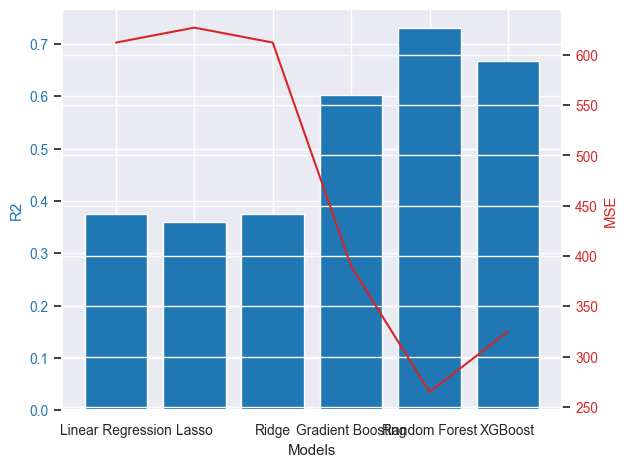

In [25]:
# Plotting
fig, ax1 = plt.subplots()
ax1.set_xlabel('Models')
ax1.set_ylabel('R2', color='tab:blue')
ax1.bar([model_info['name'] for model_info in models], r2_scores, color='tab:blue')
ax1.tick_params(axis='y', labelcolor='tab:blue')

ax2 = ax1.twinx()  
ax2.set_ylabel('MSE', color='tab:red')  
ax2.plot([model_info['name'] for model_info in models], mse_scores, color='tab:red')
ax2.tick_params(axis='y', labelcolor='tab:red')

fig.tight_layout()  
plt.show()



In [26]:
# Print the dictionary of mse values
print("********MSE VALUES*********")
print(cloud_mse_dict)

********MSE VALUES*********
{'Linear Regression': 612.1491244486998, 'Lasso': 627.0055342540646, 'Ridge': 612.1659132728546, 'Gradient Boosting': 389.90796907555267, 'Random Forest': 264.8373729777721, 'XGBoost': 324.8988908115879}


In [27]:
# Convert the dictionaries into dataframes
mse_df = pd.DataFrame.from_dict(mse_dict, orient='index', columns=['mse'])
feels_like_mse_df = pd.DataFrame.from_dict(feels_like_mse_dict, orient='index', columns=['mse'])
cloud_mse_df = pd.DataFrame.from_dict(cloud_mse_dict, orient='index', columns=['mse'])
print("MEAN SQUARED Error for temperature in celsius\n")
print(mse_df)
print("MEAN SQUARED Error for feels like temperature in celsius\n")
print(feels_like_mse_df)
print("MEAN SQUARED Error for cloud\n")
print(cloud_mse_df)

MEAN SQUARED Error for temperature in celsius

                         mse
Linear Regression  10.152643
Lasso              10.194053
Ridge              10.152679
Gradient Boosting   4.832718
Random Forest       2.270947
XGBoost             2.937290
MEAN SQUARED Error for feels like temperature in celsius

                         mse
Linear Regression  13.391613
Lasso              13.433273
Ridge              13.391654
Gradient Boosting   7.075959
Random Forest       3.219295
XGBoost             4.202152
MEAN SQUARED Error for cloud

                          mse
Linear Regression  612.149124
Lasso              627.005534
Ridge              612.165913
Gradient Boosting  389.907969
Random Forest      264.837373
XGBoost            324.898891


# Comparison of Different Mean Squared Errors

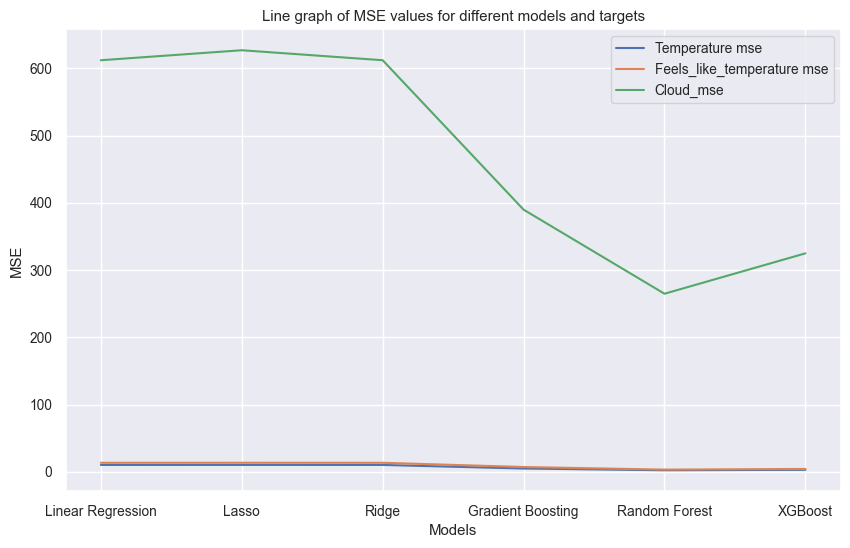

In [28]:
# Plot a line graph for the mse values
plt.figure(figsize=(10, 6))
plt.plot(mse_df, label='Temperature mse')
plt.plot(feels_like_mse_df, label='Feels_like_temperature mse')
plt.plot(cloud_mse_df, label='Cloud_mse')
plt.xlabel('Models')
plt.ylabel('MSE')
plt.title('Line graph of MSE values for different models and targets')
plt.legend()
plt.show()

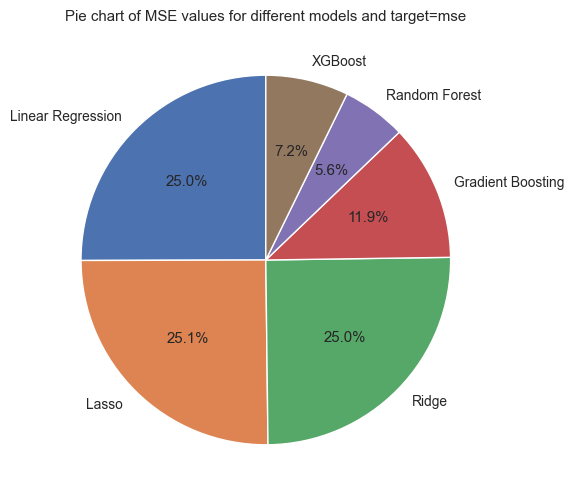

In [29]:
# Plot a pie chart for the mse values
plt.figure(figsize=(10, 6))
plt.pie(mse_df['mse'], labels=mse_df.index, autopct='%1.1f%%', startangle=90)
plt.title('Pie chart of MSE values for different models and target=mse')
plt.show()